## Spotify Skip RL Model

Elise Rust 

In [1]:
from pathlib import Path
import pandas as pd
import numpy as np
from numpy.linalg import norm
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import OneHotEncoder
from sklearn import preprocessing
import warnings
from itertools import tee

# Suppress scientific notation
pd.options.display.float_format = '{:20,.2f}'.format

warnings.filterwarnings("ignore")

## Data Pre-Processing
1. Join session level data with track context/features
2. Identify all unique transitions from song a to song b --> store in dictionary for future sampling during training
3. Convert rewards to binary 0 = skipped, 1 = not skipped
4. Encode categorical track and session features
5. Create Features dataframe which containes cleaned/OHE vector of track features
6. Generate session context encoding
    - How each session has responded to tracks of given features
    - Normalize features between 0 - 1
    - Multiply feature by 1 if user didn't skip, -1 if user did skip
    - I.e for a given session their context would look like
    
|duration|us_popularity|acousticness|beat_strength|bounciness|danceability|dyn_range|energy|flatness|etc.
|------|-------|-------|-------|-------|-------|-------|-------|-------|-------|
|   109.5|      99.2|      0.5|      0.7|      0.3|      0.2|      0.2|      7.5|      0.8|      etc.|

Normalize the session level response to song features on a 0-1 scale


In [2]:
# Load in Data
df_sessions_sampled = pd.read_csv('data/training_set/log_sampled.csv')
df_tracks_sampled = pd.read_csv('data/track_features/tf_sampled.csv')
print("Number of sessions in DF: " + str(len(df_sessions_sampled['session_id'].unique())))
print("Number of tracks in DF: " + str(len(df_tracks_sampled['track_id'].unique())))
# Sanity check num tracks in tracks df equals num tracks in sessions df
assert len(df_sessions_sampled['track_id_clean'].unique()) == len(df_tracks_sampled['track_id'].unique())

Number of sessions in DF: 178342
Number of tracks in DF: 319008


In [3]:
## Check for nulls, etc.
print("Missing values in sessions data: ", df_sessions_sampled.isna().sum())
print("Missing values in track data: ", df_sessions_sampled.isna().sum())

Missing values in sessions data:  session_id                         0
session_position                   0
session_length                     0
track_id_clean                     0
skip_1                             0
skip_2                             0
skip_3                             0
not_skipped                        0
context_switch                     0
no_pause_before_play               0
short_pause_before_play            0
long_pause_before_play             0
hist_user_behavior_n_seekfwd       0
hist_user_behavior_n_seekback      0
hist_user_behavior_is_shuffle      0
hour_of_day                        0
date                               0
premium                            0
context_type                       0
hist_user_behavior_reason_start    0
hist_user_behavior_reason_end      0
dtype: int64
Missing values in track data:  session_id                         0
session_position                   0
session_length                     0
track_id_clean                    

In [4]:
## Examine columns and datatypes in each dataframe
print(df_sessions_sampled.dtypes)
print("-----------------------")
print(df_tracks_sampled.dtypes)

session_id                         object
session_position                    int64
session_length                      int64
track_id_clean                     object
skip_1                               bool
skip_2                               bool
skip_3                               bool
not_skipped                          bool
context_switch                      int64
no_pause_before_play                int64
short_pause_before_play             int64
long_pause_before_play              int64
hist_user_behavior_n_seekfwd        int64
hist_user_behavior_n_seekback       int64
hist_user_behavior_is_shuffle        bool
hour_of_day                         int64
date                               object
premium                              bool
context_type                       object
hist_user_behavior_reason_start    object
hist_user_behavior_reason_end      object
dtype: object
-----------------------
track_id                   object
duration                  float64
release_year

In [24]:
## Join dataframes together on 'track_id'
spotify = df_sessions_sampled.merge(df_tracks_sampled, left_on="track_id_clean", right_on="track_id")
print(spotify.isna().sum())
spotify.head()

session_id                         0
session_position                   0
session_length                     0
track_id_clean                     0
skip_1                             0
skip_2                             0
skip_3                             0
not_skipped                        0
context_switch                     0
no_pause_before_play               0
short_pause_before_play            0
long_pause_before_play             0
hist_user_behavior_n_seekfwd       0
hist_user_behavior_n_seekback      0
hist_user_behavior_is_shuffle      0
hour_of_day                        0
date                               0
premium                            0
context_type                       0
hist_user_behavior_reason_start    0
hist_user_behavior_reason_end      0
track_id                           0
duration                           0
release_year                       0
us_popularity_estimate             0
acousticness                       0
beat_strength                      0
b

,session_id,session_position,session_length,track_id_clean,skip_1,skip_2,skip_3,not_skipped,context_switch,no_pause_before_play,...,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,False,True,0,0,...,4,0.15,-0.82,0.39,0.23,0.03,-0.33,0.02,-0.35,0.21
1,0_00079a23-1600-486a-91bd-5208be0c745a,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,True,False,0,0,...,4,0.15,-0.82,0.39,0.23,0.03,-0.33,0.02,-0.35,0.21
2,0_012b0fb4-0cc3-429f-9a78-cc6e622153fb,6,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,False,True,0,0,...,4,0.15,-0.82,0.39,0.23,0.03,-0.33,0.02,-0.35,0.21
3,0_013cc010-c476-4ad2-8972-73449e0b2ef4,9,13,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,False,True,0,1,...,4,0.15,-0.82,0.39,0.23,0.03,-0.33,0.02,-0.35,0.21
4,0_01a5f0dc-9938-48c9-92f1-c7e51f34d290,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,True,False,0,0,...,4,0.15,-0.82,0.39,0.23,0.03,-0.33,0.02,-0.35,0.21


In [25]:
## Drop unnecessary columns
spotify = spotify.drop(columns=['hist_user_behavior_reason_start', 'acoustic_vector_0', 'acoustic_vector_1', 'acoustic_vector_2', 'acoustic_vector_3', 'acoustic_vector_4', 'acoustic_vector_5', 'acoustic_vector_6', 'acoustic_vector_7'])

In [34]:
# ## Count unique songs
# print("Unique songs in dataset: ", len(spotify.track_id.unique()))

# ## Map how many unique transitions between song x and song y exist
# def pairwise(iterable):
#     a,b = tee(iterable)
#     next(b, None)
#     return zip(a,b)

# def count_transitions(df=spotify, track_id='track_id', seq='session_position'):
#     '''
#     Inputs:
#     - A dataframe
#     - Column containing unique track ids
#     - Sequence column indicating the position in session each track is in

#     NOTE: This method is insanely inefficient if anyone has suggestions
#     '''

#     unique_transitions = [] # Count number of unique transitions
#     transitions_dict = {} # Store unique tracks each song can transition to
#     for s in df.track_id.unique(): # Set unique tracks as keys
#         transitions_dict[s] = []

#     for (i1, row1), (i2, row2) in pairwise(spotify.iterrows()):
#         # Loop through all pairs of tracks --> not efficient but should do the trick
#         track1 = row1['track_id']
#         track2 = row2['track_id']
#         position1 = row1['session_position']
#         position2 = row2['session_position']
#         # Boolean initialization
#         transition=False
#         unique=False

#         if [track1, track2] not in unique_transitions:
#             unique = True
#         if position2 == position1+1: # If the tracks are sequential
#             transition = True
#             transitions_dict[track1].append(track2)
        
#         if (unique and transition):
#             unique_transitions.append([track1, track2])
        
    
#     return transitions_dict, (len(unique_transitions))
    
# transitions_dict, num_transitions = count_transitions()

Unique songs in dataset:  319008
Number of unique song transitions in dataframe:  133873
{'t_0479f24c-27d2-46d6-a00c-7ec928f2b539': ['t_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-

In [61]:
# print("Number of unique song transitions in dataframe: ", num_transitions)
# print(dict(list(transitions_dict.items())[0: 1]))

Number of unique song transitions in dataframe:  133873
{'t_0479f24c-27d2-46d6-a00c-7ec928f2b539': ['t_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-46d6-a00c-7ec928f2b539', 't_0479f24c-27d2-4

#### Encode rewards
- The agent learns via the 'skip' variables (this is how we get feedback on whether the user likes or doesn't like a given song)
- Convert 'skip_1', 'skip_2', 'skip_3', 'not_skipped' into binary 'skip' variable (1/0; -1 if user skips)

Reward is thus:
+1 if song is not skipped
-1 if song is skipped

In [26]:
spotify['response'] = np.where(
    spotify['not_skipped']==True,
    1,
    -1
)
spotify = spotify.drop(columns=['skip_1', 'skip_2', 'skip_3', 'not_skipped'])
spotify.head()

,session_id,session_position,session_length,track_id_clean,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,...,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,response
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,0,0,0,0,...,0.68,-6.58,0.55,major,0.32,0.07,134.02,4,0.15,1
1,0_00079a23-1600-486a-91bd-5208be0c745a,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.68,-6.58,0.55,major,0.32,0.07,134.02,4,0.15,-1
2,0_012b0fb4-0cc3-429f-9a78-cc6e622153fb,6,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.68,-6.58,0.55,major,0.32,0.07,134.02,4,0.15,1
3,0_013cc010-c476-4ad2-8972-73449e0b2ef4,9,13,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,1,0,0,0,0,...,0.68,-6.58,0.55,major,0.32,0.07,134.02,4,0.15,1
4,0_01a5f0dc-9938-48c9-92f1-c7e51f34d290,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.68,-6.58,0.55,major,0.32,0.07,134.02,4,0.15,-1


## Encode relevant user context data - behavior
To booleans:
- shuffle (0/1)
- premium (0/1)

To numeric:
- date --> year, month

To OHE vectors:
- context (catalog, charts, editorial playlist, personalized playlist, radio, user collection)
- track end reason (appload, backbtn, clickrow, endplay, fwdbtn, logout, remote, trackdone)

In [27]:
# Convert binary columns to booleans
data_bool_cols = spotify.columns[spotify.dtypes=='bool']
for col in data_bool_cols:
    spotify[col]=spotify[col].astype(int)
spotify['mode'] = spotify['mode'].astype(bool).astype(int)

In [28]:
from datetime import datetime

spotify['date'] = pd.to_datetime(spotify.date, format='%Y-%m-%d')
spotify['year']=spotify['date'].dt.year
spotify['month']=spotify['date'].dt.month
spotify = spotify.drop(columns='date')
spotify.head()

,session_id,session_position,session_length,track_id_clean,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,...,mechanism,mode,organism,speechiness,tempo,time_signature,valence,response,year,month
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,0,0,0,0,...,0.55,1,0.32,0.07,134.02,4,0.15,1,2018,7
1,0_00079a23-1600-486a-91bd-5208be0c745a,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.55,1,0.32,0.07,134.02,4,0.15,-1,2018,7
2,0_012b0fb4-0cc3-429f-9a78-cc6e622153fb,6,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.55,1,0.32,0.07,134.02,4,0.15,1,2018,7
3,0_013cc010-c476-4ad2-8972-73449e0b2ef4,9,13,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,1,0,0,0,0,...,0.55,1,0.32,0.07,134.02,4,0.15,1,2018,7
4,0_01a5f0dc-9938-48c9-92f1-c7e51f34d290,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.55,1,0.32,0.07,134.02,4,0.15,-1,2018,7


In [29]:
# OHE Categorical Columns
categorical_columns =['context_type', 'hist_user_behavior_reason_end']
enc = OneHotEncoder()
array_hot_encoded = enc.fit_transform(spotify[categorical_columns]).toarray()
feature_labels = enc.categories_
feature_labels = np.concatenate(feature_labels, axis=0)
data_hot_encoded = pd.DataFrame(array_hot_encoded, columns=feature_labels, index=spotify.index) # Convert OHE array to df
spotify = spotify.drop(columns=categorical_columns)
spotify_enc = pd.concat([spotify, data_hot_encoded], axis=1)
spotify_enc.head()

,session_id,session_position,session_length,track_id_clean,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,...,appload,backbtn,clickrow,endplay,fwdbtn,logout,popup,remote,trackdone,uriopen
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,0,0,0,0,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
1,0_00079a23-1600-486a-91bd-5208be0c745a,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00
2,0_012b0fb4-0cc3-429f-9a78-cc6e622153fb,6,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
3,0_013cc010-c476-4ad2-8972-73449e0b2ef4,9,13,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,1,0,0,0,0,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
4,0_01a5f0dc-9938-48c9-92f1-c7e51f34d290,7,12,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0,0,1,1,0,0,...,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00


### Session Context Encoding - track preferences

In [40]:
feature_columns = ['duration', 'us_popularity_estimate', 'acousticness', 'beat_strength', 'bounciness',
       'danceability', 'dyn_range_mean', 'energy', 'flatness', 'instrumentalness', 'key', 'liveness',
        'loudness', 'mechanism', 'organism', 'speechiness', 'tempo', 'time_signature', 'valence',
       'response']

In [41]:
# Normalize all features to be between 0 and 1
for i in feature_columns:
    # print(i)
    #spotify_enc[i] /= np.max(np.abs(spotify_enc[i]),axis=0) # Between -1 and 1
    spotify_enc[i] = (spotify_enc[i]-np.min(spotify_enc[i]))/(np.max(spotify_enc[i])-np.min(spotify_enc[i]))

In [289]:
spotify_enc[feature_columns].describe()

,duration,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,organism,speechiness,tempo,time_signature,valence,response
count,"2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00","2,990,609.00"
mean,0.11,0.97,0.22,0.55,0.60,0.67,0.24,0.63,0.89,0.03,0.47,0.19,0.83,0.59,0.36,0.15,0.50,0.79,0.46,0.34
std,0.03,0.09,0.25,0.16,0.18,0.16,0.07,0.18,0.03,0.14,0.33,0.15,0.05,0.21,0.19,0.14,0.12,0.07,0.23,0.47
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.09,0.99,0.03,0.44,0.46,0.56,0.19,0.51,0.88,0.00,0.09,0.10,0.81,0.45,0.21,0.05,0.40,0.80,0.28,0.00
50%,0.10,1.00,0.12,0.55,0.61,0.69,0.23,0.63,0.90,0.00,0.45,0.13,0.84,0.64,0.32,0.09,0.51,0.80,0.44,0.00
75%,0.12,1.00,0.34,0.67,0.74,0.79,0.28,0.76,0.92,0.00,0.82,0.24,0.86,0.76,0.49,0.21,0.59,0.80,0.63,1.00
max,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


In [42]:
def encode_track_preferences(session_responses, feature_columns):
    '''
    Input:
    session_responses = dataframe of session (track features, behavior, etc.)
    song_context = list of variables related to track features
    '''

    # Get reviews of songs (1 vs. 0 skip outcome) * track features
    ratings = session_responses[feature_columns].mul(session_responses['response'], axis=0)
    
    # Average across session --> one vector per session
    session_pref = ratings.mean(axis=0)
    #print(session_pref)

    return session_pref


In [167]:
session_pref = spotify_enc.groupby('session_id').apply(lambda x: encode_track_preferences(x, feature_columns))

In [173]:
session_pref.index.name = 'session_id'
session_pref.reset_index(inplace=True)

In [174]:
session_pref.head()

,session_id,duration,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,...,key,liveness,loudness,mechanism,organism,speechiness,tempo,time_signature,valence,response
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,0.03,0.30,0.06,0.19,0.21,0.24,0.08,0.17,0.27,...,0.12,0.06,0.25,0.20,0.10,0.05,0.15,0.24,0.14,0.30
1,0_0000a72b-09ac-412f-b452-9b9e79bded8f,0.07,0.22,0.03,0.11,0.11,0.14,0.05,0.23,0.25,...,0.13,0.20,0.24,0.09,0.16,0.02,0.15,0.24,0.16,0.30
2,0_00010fc5-b79e-4cdf-bc4c-f140d0f99a3a,0.01,0.10,0.01,0.07,0.08,0.08,0.03,0.05,0.09,...,0.08,0.01,0.08,0.07,0.03,0.03,0.06,0.08,0.05,0.10
3,0_00016a3d-9076-4f67-918f-f29e3ce160dc,0.02,0.20,0.02,0.11,0.11,0.14,0.04,0.16,0.17,...,0.15,0.04,0.17,0.16,0.03,0.01,0.09,0.16,0.15,0.20
4,0_00018b58-deb8-4f98-ac5e-d7e01b346130,0.05,0.55,0.01,0.27,0.28,0.37,0.11,0.41,0.48,...,0.16,0.07,0.48,0.41,0.10,0.05,0.29,0.44,0.34,0.55


In [318]:
tracks = spotify_enc[['track_id_clean','duration', 'us_popularity_estimate', 'acousticness', 'beat_strength', 'bounciness',
       'danceability', 'dyn_range_mean', 'energy', 'flatness', 'instrumentalness', 'key', 'liveness',
        'loudness', 'mechanism', 'organism', 'speechiness', 'tempo', 'time_signature', 'valence']]

In [319]:
tracks = tracks.drop_duplicates()

In [320]:
tracks.head()

,track_id_clean,duration,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,organism,speechiness,tempo,time_signature,valence
0,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,0.08,1.00,0.02,0.44,0.49,0.66,0.20,0.55,0.92,0.00,0.09,0.68,0.84,0.55,0.33,0.07,0.55,0.80,0.15
865,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,0.12,0.99,0.06,0.66,0.76,0.88,0.30,0.73,0.91,0.00,0.64,0.10,0.86,0.82,0.14,0.06,0.53,0.80,0.34
891,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,0.11,1.00,0.36,0.54,0.56,0.68,0.21,0.56,0.91,0.00,0.91,0.14,0.85,0.77,0.31,0.05,0.59,0.80,0.37
6423,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,0.08,1.00,0.77,0.65,0.75,0.87,0.30,0.53,0.88,0.00,0.09,0.10,0.82,0.63,0.62,0.24,0.46,0.80,0.65
6844,t_64f3743c-f624-46bb-a579-0f3f9a07a123,0.10,1.00,0.01,0.74,0.82,0.86,0.32,0.65,0.89,0.00,0.73,0.12,0.87,0.76,0.18,0.25,0.60,0.80,0.65


In [321]:
tracks = tracks.reset_index()

In [327]:
tracks = tracks.iloc[:,1:]

In [58]:
def cosine_sim(A, B):
    A = np.array(A)
    B = np.array(B)
    return A.dot(B)/(np.sqrt(np.sum(A**2))*np.sqrt(np.sum(B**2)))

In [102]:
def ground_truth(session_context, track_features):
    track_features = np.array(track_features)
    session_context = np.array(session_context)
    try: return np.array([cosine_sim(i,session_context) for i in track_features])
    except: return cosine_sim(track_features, session_context)

In [104]:
def calculate_regret(selected_rated, inventory_ratings):
    return max(inventory_ratings) - selected_rated

In [281]:
x_dimension = 119

In [282]:
def eps_greedy(model, session_context, track_inventory, eps):
    selected_track = None
    selected_x = None
    max_action_val = 0
    
    # IF A RANDOM NUMBER BETWEEN 0 AND 1 IS LESS THAN OUR EPS HYPERPARAMETER WE CHOOSE A RANDOM AD
    if np.random.uniform() < eps:
        selected_track = np.random.choice(list(track_inventory.keys()))
        selected_x = np.concatenate((session_context ,track_inventory[selected_track]), axis = None).reshape(x_dimension,)    
    # OTHERWISE WE GET THE AD(S) WITH THE HIGHEST PREDICTED CTR(S)
    else:
        for track in track_inventory.items():
            x = np.concatenate((session_context, track[1]), axis = None).reshape(1,-1)            
            action_val_pred = model.predict(x)
            if action_val_pred >= max_action_val:
                max_action_val = action_val_pred
                selected_track = track[0]
                selected_x = x

    return selected_track, selected_x.reshape(x_dimension,)

In [347]:
from sklearn.linear_model import LinearRegression
import math
impressions = 1000
n_movie_inventory = 5
batch_size = 50
eps = [0.05] 
regret_vec = {}
for e in eps:
    print('e = ',e, '\n')
    movie_model = LinearRegression()
    X = []
    y = []
    total_regret = 0
    regret_vec[e] = []
    
    for i in range(impressions):
        # SAMPLE ALL MOVIES FOR THE MOVIE INVENTORY
        movie_inventory = tracks.sample(n = n_movie_inventory)
        movie_context = {i[0]: i[1:] for i in np.array(movie_inventory)}
        
        # SAMPLE A SINGLE USER FROM THE FULL LIST AND SAVE THE USER'S CONTEXT
        session_id_sample = np.array(spotify_enc.sample(n = 1))[0][0]
        user_context = np.array(spotify_enc[spotify_enc.session_id == session_id_sample].sample(5)[feature_columns]).flatten()
        
        # IF THE RANDOM FOREST HAS NOT BEEN TRAINED WE MAKE A RANDOM SELECTION
        if i < batch_size:
            selected_movie_id = np.random.choice(list(movie_context.keys()))
            selected_x = np.concatenate((user_context ,movie_context[selected_movie_id]), axis = None).reshape(x_dimension,)
        # ELSE WE SELECT THE MOVIE WITH THE HIGHEST PREDICTED REVIEW
        else:
            selected_movie_id, selected_x = eps_greedy(movie_model, user_context, movie_context, e)
            
        user_context_evaluate = np.array(session_pref[session_pref.session_id == session_id_sample])[0,1:-1]
        
        # GET THE USER'S RATING (GROUND TRUTH) FOR THE SELECTED MOVIE
        truth_selected_rate = cosine_sim(user_context_evaluate, movie_context[selected_movie_id])
        truth_rates = ground_truth(user_context_evaluate, np.array(movie_inventory)[:,1:])
        # print(truth_rates)

        # CALCULATE THE REGRET
        regret = calculate_regret(truth_selected_rate, truth_rates)
        
        # SAVE SELECTED CONTEXT, REWARD, REGRET AND TOTAL REGRET
        if ~np.isfinite(selected_x.astype(float)).any() or math.isnan(truth_selected_rate):
            continue
        else:
            X.append(selected_x)
            y.append(truth_selected_rate)

        total_regret += regret
        regret_vec[e].append(total_regret)

        # UPDATE THE MODEL AT THE END OF THE BATCH
        if (i + 1)%batch_size == 0:
            print('Updating the model after {} impressions'.format(i+1))
            movie_model.fit(X,y)


e =  0.05 

Updating the model after 50 impressions
Updating the model after 100 impressions
Updating the model after 150 impressions
Updating the model after 200 impressions
Updating the model after 250 impressions
Updating the model after 300 impressions
Updating the model after 350 impressions
Updating the model after 400 impressions
Updating the model after 450 impressions
Updating the model after 500 impressions
Updating the model after 550 impressions
Updating the model after 600 impressions
Updating the model after 650 impressions
Updating the model after 700 impressions
Updating the model after 750 impressions
Updating the model after 800 impressions
Updating the model after 850 impressions
Updating the model after 900 impressions
Updating the model after 950 impressions
Updating the model after 1000 impressions


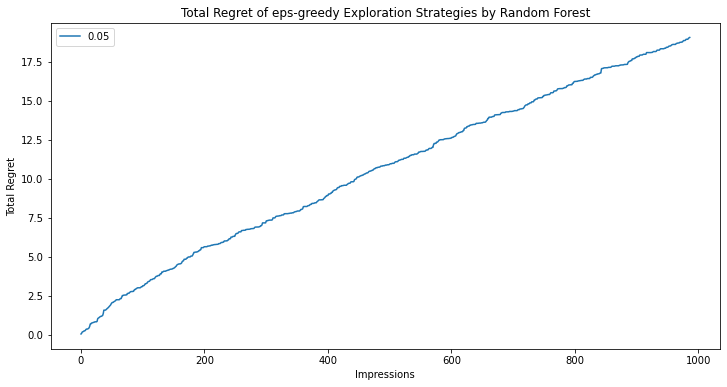

In [349]:
fig, ax = plt.subplots(figsize=(12, 6))
for e in eps:
    ax.plot(range(len(regret_vec[e])), regret_vec[e])
ax.set_ylabel('Total Regret')
ax.set_xlabel('Impressions')
ax.set_title('Total Regret of eps-greedy Exploration Strategies by Random Forest')
ax.legend(eps)
plt.show()